# American City (by zip) Cluster Analysis

In [1]:
#%reload_ext nb_black

In [2]:
import pandas as pd
import numpy as np

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, silhouette_score
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier

import plotly.express as px
import matplotlib.pyplot as plt

from time import sleep
from tqdm import tqdm_notebook as tqdm

%matplotlib inline

In [3]:
zip_code_data_url = "https://docs.google.com/spreadsheets/d/1Hwe4GX30AjfFU9kRbUC5PCfN07CsChjaQH8DzurRb6U/export?format=csv"

df = pd.read_csv(zip_code_data_url)
df = df.set_index("post_office_city")

df.shape
df.head(2)

,zipcode,zipcode_type,major_city,county,state,lat,lng,timezone,population,population_density,total_wage,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income
post_office_city,,,,,,,,,,,,,,,,,
"Moody, AL",35004,Standard,Moody,St. Clair County,AL,33.62,-86.50,Central,10427.0,577.0,NaN,18.07,0.14,4523.0,4214.0,142500.0,58832.0
"Adamsville, AL",35005,Standard,Adamsville,Jefferson County,AL,33.59,-86.99,Central,7942.0,230.0,NaN,34.51,0.35,3485.0,3067.0,97000.0,46059.0


In [4]:
cluster_cols = [
    "population",
    "population_density",
    "land_area_in_sqmi",
    "water_area_in_sqmi",
    "housing_units",
    "occupied_housing_units",
    "median_home_value",
    "median_household_income",
]

df = df.dropna(subset=cluster_cols)
X = df[cluster_cols]
X.head(2)

,population,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income
post_office_city,,,,,,,,
"Moody, AL",10427.0,577.0,18.07,0.14,4523.0,4214.0,142500.0,58832.0
"Adamsville, AL",7942.0,230.0,34.51,0.35,3485.0,3067.0,97000.0,46059.0


Some redundant variables (ie housing and population likely correlated).  Performing PCA before clustering to avoid redundancy or feature selection.

In [5]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(3)
pcs = pca.fit_transform(X_scaled)
pcs = pd.DataFrame(pcs, columns=["pc1", "pc2", "pc3"], index=X.index)

In [6]:
np.sum(pca.explained_variance_ratio_)

0.7912291143110504

Taking a look at what contributes to each of the components.

In [7]:
loadings = pca.components_.T
loadings = pd.DataFrame(loadings, columns=pcs.columns, index=X.columns)
loadings.style.background_gradient(axis=1)

,pc1,pc2,pc3
population,0.510343,0.193714,-0.046519
population_density,0.311627,-0.027254,-0.028610
land_area_in_sqmi,-0.073002,0.343255,0.606091
water_area_in_sqmi,-0.023582,0.270646,0.661138
housing_units,0.512817,0.205045,-0.043406
occupied_housing_units,0.516341,0.193529,-0.046281
median_home_value,0.270929,-0.557305,0.298581
median_household_income,0.183196,-0.616906,0.315265


* Records with high values in `pc1` are expected to be more dense/rich areas.  Plot below shows that New York City and surrounding areas are highest in this component.
* Records with high `pc2` are expected to be less dense/poor areas.  Plot below shows that Alaskan towns are highest in this component.
* Records with high `pc3` are expected to have higher land/water area.  Plot below shows that Alaskan towns are highest in this component.

In [8]:
plot_df = pd.concat((pcs, X), axis=1)
plot_df = plot_df.reset_index()
px.scatter(
    data_frame=plot_df,
    x="pc1",
    y="pc2",
    color="pc3",
    hover_data=plot_df.columns,
)

* I'd like at least 3 clusters, but not going crazy with more than 7
* *Lazily* having just silhouette_score choose k for me (this should be the starting point, but centroid/cluster analysis should guide final decision).

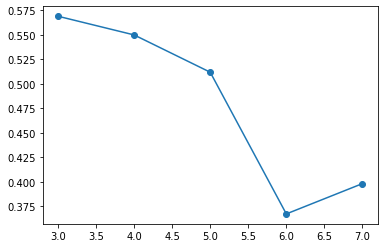

In [9]:
ks = range(3, 8)
scores = []

best_scoring_k = -1
for k in tqdm(ks):
    kmeans = KMeans(k)
    kmeans.fit(pcs)

    score = silhouette_score(pcs, kmeans.labels_)

    # Save k as best scoring k if
    # no scores yet or if score is highest yet
    if not scores or score > max(scores):
        best_scoring_k = k
    scores.append(score)

plt.plot(ks, scores, "o-")
plt.show()

In [10]:
kmeans = KMeans(best_scoring_k)
kmeans.fit(pcs)

KMeans(n_clusters=3)

In [11]:
labels = pd.Series(kmeans.labels_)
label_counts = pd.concat(
    (labels.value_counts(normalize=True), labels.value_counts()), axis=1
)
label_counts.columns = ["percent of records", "count of records"]
label_counts.index.name = "cluster"
label_counts

,percent of records,count of records
cluster,,
0,0.786568,24736
1,0.212541,6684
2,0.000890,28


In [12]:
labeled_X = X.copy()
labeled_X["label"] = kmeans.labels_

clst_avgs = labeled_X.groupby("label").mean()
clst_avgs = clst_avgs.sort_values(clst_avgs.columns[0])
clst_avgs.style.background_gradient()

,population,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income
label,,,,,,,,
2,3579.857143,1.214286,5002.057500,302.682143,1667.357143,1353.107143,171125.000000,55547.035714
0,3797.925817,326.577337,95.688186,1.864573,1729.206905,1458.740783,142868.225218,49179.496079
1,31949.021544,4451.267804,45.157804,1.368202,13267.412478,12035.271095,270243.087074,63284.488929


* General cluster statements:
    * Population density is a big big difference between all three clusters (Cluster 2 by far least dense; Cluster 1 by far most dense)
    * Cluster 2 by far the most land and water area
    * Cluster 0 seems to have captured the "typical" american town.  very large cluster with average features all falling in middle of other 2 clusters.
    
* High level summary of each cluster
    * Cluster 0 (79%) - run of the mill american town
    * Cluster 1 (21%) - bigger cities
    * Cluster 2 (0.089%) - rural less populated areas with lots of land

In [13]:
plot_df = pd.concat((pcs, labeled_X), axis=1)
plot_df["label"] = plot_df["label"].astype(str)
plot_df = plot_df.reset_index()
px.scatter(
    data_frame=plot_df,
    x="pc1",
    y="pc2",
    color="label",
    hover_data=plot_df.columns,
)

Some cities from each cluster:

In [14]:
labeled_X = labeled_X[["label"] + cluster_cols]
sample = labeled_X.groupby("label").sample(3)
sample.style.background_gradient()

,label,population,population_density,land_area_in_sqmi,water_area_in_sqmi,housing_units,occupied_housing_units,median_home_value,median_household_income
post_office_city,,,,,,,,,
"Filer, ID",0,5347.000000,80.000000,66.860000,0.740000,2106.000000,1985.000000,139700.000000,42098.000000
"Moultonborough, NH",0,4049.000000,68.000000,59.500000,15.140000,4958.000000,1744.000000,318800.000000,72110.000000
"Freeport, PA",0,4997.000000,201.000000,24.900000,1.000000,2198.000000,2034.000000,135100.000000,59394.000000
"Kent, WA",1,43673.000000,1537.000000,28.410000,1.210000,15820.000000,15097.000000,297100.000000,87342.000000
"San Francisco, CA",1,26237.000000,34749.000000,0.760000,0.250000,15197.000000,13507.000000,931200.000000,50485.000000
"Saint Paul, MN",1,37759.000000,1564.000000,24.150000,6.190000,15844.000000,15122.000000,218700.000000,68618.000000
"Wrangell, AK",2,2338.000000,1.000000,2161.610000,246.110000,1339.000000,1037.000000,157300.000000,45649.000000
"King Salmon, AK",2,434.000000,0.000000,3695.680000,303.210000,495.000000,179.000000,183000.000000,81250.000000
"Petersburg, AK",2,3202.000000,1.000000,2683.000000,666.970000,1637.000000,1363.000000,224100.000000,68646.000000


By request: Use these cluster labels to build a supervised learning model.

In [15]:
y = kmeans.labels_

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

pipeline = Pipeline(
    [("scale", StandardScaler()), ("rf", RandomForestClassifier(max_depth=3))]
)
pipeline.fit(X_train, y_train)

print(f"Train score: {pipeline.score(X_train, y_train)}")
print(f"Test score: {pipeline.score(X_test, y_test)}")

y_pred = pipeline.predict(X_test)

confusion_mat = confusion_matrix(y_test, y_pred)
pd.DataFrame(
    confusion_mat,
    columns=["Predicted 0", "Predicted 1", "Predicted 2"],
    index=["Actual 0", "Actual 1", "Actual 2"],
)

Train score: 0.9776611813339693
Test score: 0.9779014308426073


,Predicted 0,Predicted 1,Predicted 2
Actual 0,4914,33,0
Actual 1,100,1237,0
Actual 2,6,0,0


Class imbalance issues on Predicting the small class 2.

In [16]:
feature_importance = pipeline["rf"].feature_importances_
feature_importance = pd.DataFrame(
    {"importance": feature_importance, "feature": X_train.columns}
)
feature_importance.sort_values("importance", ascending=False)

,importance,feature
5,0.368229,occupied_housing_units
0,0.298588,population
4,0.167410,housing_units
1,0.110245,population_density
6,0.023764,median_home_value
2,0.019980,land_area_in_sqmi
7,0.010865,median_household_income
3,0.000919,water_area_in_sqmi
